## Kuramoto model of $N$ coupled oscillators as defined in https://arxiv.org/abs/2108.12129

$$\dot{\theta_i} = \omega_i + K \sum^N_{j=1} A_{ij} \sin(\theta_j - \theta_i),$$

where $\theta_i$ is the phase angle of oscillator $i$, $\omega_i$ is the natural frequency of the oscillator $i$, $K$ is the coupling strenght and $A$ is the adjacency matrix of the oscillator network.



#### 1. Construct a regular frequency assortative network

Algorithm for adding edges to the network:

1. Draw natural frequencies $\omega$ uniformly from $[\frac{-\pi}{2}, \frac{\pi}{2}]$

While degree of all nodes is less than $d$:

Randomly select a node $i$ with degree < $d$

randomly pick a node $j$ not already connected to $i$ and that has degree < $d$

connect $i$ and $j$ with probability $p \propto \frac{\sigma^{\gamma}}{\sigma^{\gamma} + |{\omega_i - \omega_j}|^{\gamma}}$
        
In the paper, $N=50, d=3, \sigma=0.8, \gamma=5, K=0.5$

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
import sys
sys.path.insert(0, '..')
from reservoirpy.reservoirpy.datasets.chaos import kuramoto

In [2]:
def generate_a(N, S):
    try:
        N = N
        D = 3
        S = S
        G = 5
        K = 0.5
        omega = np.random.uniform(-np.pi/2, np.pi/2, size=N)

        g = nx.empty_graph()
        g.add_nodes_from(range(N)) #network with N nodes and no edges

        while any(g.degree(node) < D for node in g.nodes()):
            i = np.random.choice([node for node in g.nodes() if g.degree(node) < D])
            j = np.random.choice([node for node in g.nodes() if g.degree(node) < D and not g.has_edge(i, node) and node != i])

            p = (S**G)/(S**G + np.abs(omega[i]-omega[j])**G)

            if np.random.uniform(0,1) < p:
                g.add_edge(i,j)

        a = nx.to_numpy_array(g)
        return a, omega, g
    except:
        return generate_a(N, S)

In [ ]:
np.random.seed(772477)    #previous 149258
N = 30
S = 0.8
a, omega, g = generate_a(N, S)
 

for node, value in zip(g.nodes(), omega):
    g.nodes[node]['omega'] = value

cmap = plt.cm.cool

# Create a figure and axis object
fig, ax = plt.subplots()

nx.draw_networkx(g, node_color=omega, cmap=cmap, vmin=-np.pi/2, vmax=np.pi/2, ax=ax, with_labels=False)

# Color map for natural frequencies
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=-np.pi/2, vmax=np.pi/2))
sm.set_array(omega)
#cbar = plt.colorbar(sm, ax=ax)  # Pass the axis object to colorbar function
#cbar.set_label(r'$\Omega$', rotation=0)
#plt.show()
fig.patch.set_visible(False)
ax.axis('off')
plt.savefig("kuramoto30.png", format="png")

In [4]:
nx.numeric_assortativity_coefficient(g,'omega')

0.8000797242100223

In [137]:
plt.savefig("high_assort.pdf", format="pdf")

<Figure size 640x480 with 0 Axes>

In [4]:
#find low or high assortativity networks

def find_assortative_net(N, S, target, n_trials = 100):
    """
    find frequency-assortative network with given assortativity.
    target: target assortativity, between 0 and 1
    """
    closest_a = np.inf
    closest_omega = None
    closest_seed = None
    assorts = []
    
    for i in range(n_trials):
        rng = np.random.default_rng()
        seed = rng.integers(999999)
        np.random.seed(seed)
        a, omega, g = generate_a(N, S)
        for node, value in zip(g.nodes(), omega):
            g.nodes[node]['omega'] = value
            
        assort = nx.numeric_assortativity_coefficient(g,'omega')
        assorts.append(assort)
        if np.abs(target-assort) < np.abs(target-closest_a):
            closest_a = assort
            closest_seed  = seed
            closest_omega = omega
    return closest_a, closest_omega, closest_seed, assorts
            

In [18]:
assort, _, s, assorts = find_assortative_net(30, 0.8, target=0.8, n_trials = 100)
assort

0.8000797242100223

In [19]:
s

772477

In [6]:
all_assorts = []
n_list = [30, 50, 70, 90]

for n in n_list:
    a, omega, s, assorts = find_assortative_net(n, 0.5, target=0.2, n_trials = 100)
    all_assorts.append(assorts)

Text(0.5, 1.0, 'Size of network N vs Frequency Assortativity')

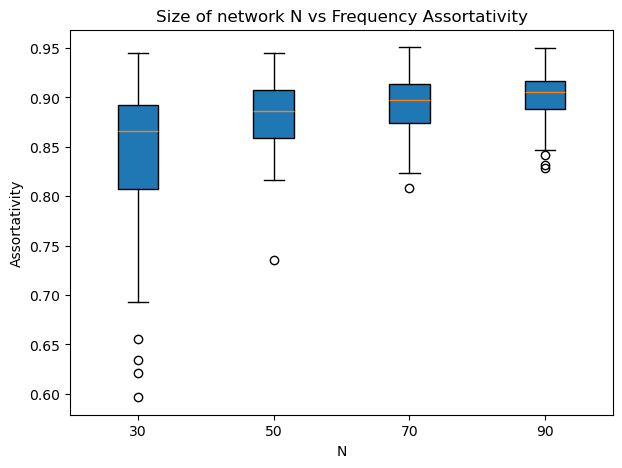

In [7]:
plt.figure(figsize=(7, 5))

#plt.subplot(1, 2, 1)
plt.boxplot(all_assorts, labels=n_list, patch_artist=True, widths=0.3)
plt.xlabel('N')
plt.ylabel(r'Assortativity')
plt.title('Size of network N vs Frequency Assortativity')
#plt.savefig("n_vs_assort.pdf", format="pdf")

In [88]:
np.mean(all_assorts[8])

0.7985817814056146

#### 2. simulation

In [4]:
def kuramoto_euler(Nstep, dt, A, omega, K, init):
    theta = np.zeros((30, Nstep))
    theta[:,0] = init
    for i in range(Nstep-1):
        dtheta = omega + K * np.sum(A.T * np.sin(theta[:, i] - theta[:, i, np.newaxis]), axis=1)
        theta[:, i + 1] = theta[:, i] + dt * dtheta
    return np.mod(theta.T, 2*np.pi)

In [16]:
timestep = 0.02
N = 30
D = 3
S = 0.8
G = 5
K = 0.5
init=np.random.uniform(0, 2*np.pi, size=N)
data, t = kuramoto.kuramoto(K=K, omega=omega, a=a, init=init, n_timesteps=80000, h=timestep, method='LSODA')

In [6]:
data = kuramoto_euler(80000, timestep, a, omega, K, init)

NameError: name 'kuramoto_euler' is not defined

In [17]:
data.shape

(80000, 30)

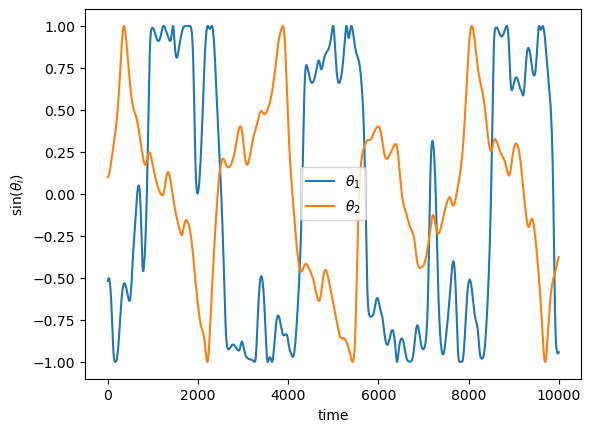

In [7]:
# plotting the beginning of a few of the oscillators
plt.plot(np.sin(data[70000:80000,8]),label=r"$\theta_1$")
plt.plot(np.sin(data[70000:80000,9]),label=r"$\theta_2$")
#plt.plot(np.sin(data[0:10000,2]),label=r"$\theta_3$")
plt.ylabel(r"sin($\theta_i$)")
plt.xlabel("time")
plt.legend()

#### 3. Global order parameter:

$$R(t) = \frac{\sum^N_{i,j=1} A_{ij}e^{i \theta_j}}{N d}$$

In [6]:
def R_t(theta, a):
    e = np.e**(1j*theta)
    return np.sum(a * e[:,np.newaxis])

def calculate_R(a:np.ndarray, data:np.ndarray, N:int, d:int):
        R = np.apply_along_axis(R_t, axis=1, arr=data, a=a)
        return R/(N*d)

In [38]:
r_t = calculate_R(a=a, data=data, N=N, d=D)
r_t.shape

(80000,)

Text(0, 0.5, '$|R(t)|$')

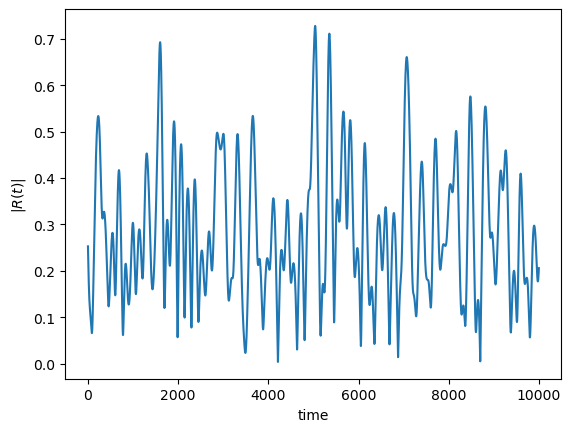

In [39]:
plt.plot(np.abs(r_t[70000:80000]))
plt.xlabel("time")
plt.ylabel(r"$|R(t)|$")

#### 4. Animation

In [22]:
from matplotlib.animation import FuncAnimation, FFMpegWriter
from matplotlib.colors import Normalize
from IPython.display import HTML

In [21]:


fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim(-1.1, 1.1)
ax.set_ylim(-1.1, 1.1)
ax.set_aspect('equal')

sc = ax.scatter(np.zeros(N), np.zeros(N), c=omega, cmap='cool', s=10, vmin=-np.pi/2, vmax=np.pi/2)
cbar = plt.colorbar(sc, ax=ax, orientation='vertical', label=r'$\Omega$')
anim_data = data[70000:,:]
anim_data = anim_data[::3, :]
num_frames = anim_data.shape[0]

def init():
    sc.set_offsets(np.empty((0, 2)))
    return sc,

def update(frame):
    angles = anim_data[frame, :]
    x = np.cos(angles)
    y = np.sin(angles)
    positions = np.column_stack((x, y))
    sc.set_offsets(positions)

    return sc,

ani = FuncAnimation(fig, update, frames=num_frames, init_func=init, blit=True)
plt.close()
HTML(ani.to_jshtml())


Animation size has reached 20977680 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [23]:
writervideo = FFMpegWriter(fps=30) 
ani.save('kuramoto.mp4', writer=writervideo)

In [11]:
# save the simulation data

train = [{"data":data[:50000], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]
validation = [{"data":data[50000:65000], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]
test = [{"data":data[65000:], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]


In [8]:
!pwd

/scratch/work/tuomaaj3/reservoir_project/notebooks_dynamic_systems


In [9]:
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/lsoda_train.npy", train)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/lsoda_validation.npy", validation)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/lsoda_test.npy", test)

In [12]:
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/euler_train.npy", train)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/euler_validation.npy", validation)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/euler_test.npy", test)

In [6]:
#np.random.seed(91596)

In [8]:
# generate data for two integration methods
N = 30
D = 3
S = 0.8
G = 5
K = 0.5
timestep = 0.03
steps = int(1600/timestep)
trsteps = int((steps*5)/8)
valsteps = int((steps*3)/16)
init=np.random.uniform(0, 2*np.pi, size=N)

data, t = kuramoto.kuramoto(K=K, omega=omega, a=a, init=init, n_timesteps=steps, h=timestep, method='LSODA')

train = [{"data":data[:trsteps], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]
validation = [{"data":data[trsteps:trsteps+valsteps], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]
test = [{"data":data[trsteps+valsteps:], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]

np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/lsoda_train_{str(timestep)[2:]}.npy", train)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/lsoda_validation_{str(timestep)[2:]}.npy", validation)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/lsoda_test_{str(timestep)[2:]}.npy", test)

data = kuramoto_euler(steps, timestep, a, omega, K, init)

train = [{"data":data[:trsteps], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]
validation = [{"data":data[trsteps:trsteps+valsteps], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]
test = [{"data":data[trsteps+valsteps:], "dt":timestep, "adjacency_matrix":a, "natural_freq":omega, "K":K, "N":N, "initLen":0}]

np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/euler_train_{str(timestep)[2:]}.npy", train)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/euler_validation_{str(timestep)[2:]}.npy", validation)
np.save(f"../notebooks/simulation_data/coupled_kuramoto/N{N}/euler_test_{str(timestep)[2:]}.npy", test)

In [ ]:
np.load("../notebooks/simulation_data/coupled_kuramoto/N20/euler_train_02.npy", allow_pickle = True)[0]["data"].shape

In [10]:
len(test[0]["data"])

10001